In [1]:
library(foreign)

In [2]:
cps2015 = read.csv("cps2015.csv")

In [3]:
cps2015.include = subset(cps2015,cps2015$age>16)

In [4]:
cps2015.include.minWage = subset(cps2015.include,cps2015.include$hourwage <= 7.25)
summary(cps2015.include.minWage)

      year          serial         hwtsupp             hhintype   
 Min.   :2014   Min.   :  141   Min.   :  219.5   Interview:4320  
 1st Qu.:2014   1st Qu.:29304   1st Qu.: 1484.3                   
 Median :2014   Median :57994   Median : 2579.3                   
 Mean   :2014   Mean   :54587   Mean   : 3114.0                   
 3rd Qu.:2014   3rd Qu.:79639   3rd Qu.: 4037.4                   
 Max.   :2014   Max.   :97898   Max.   :21319.6                   
                                                                  
                         region            statefip          statecensus  
 Pacific Division           :776   California  : 476   California  : 476  
 South Atlantic Division    :715   Texas       : 328   Texas       : 328  
 West North Central Division:533   Florida     : 146   Florida     : 146  
 West South Central Division:487   Pennsylvania: 128   Pennsylvania: 128  
 East North Central Division:457   Illinois    : 125   Illinois    : 125  
 Mountain Divi

In [5]:
table(cps2015.include.minWage$poverty_indicator)


   0    1 
3907  413 

# Delete this part of the code!!!!!! Turns out, they are the bugs that preventing the prediction function. 

In [6]:
# refactorize variables
#varNames = c("black","asian","hispanic","other","lessHS","HS","somecoll")
#cps2015.include.minWage$black=factor(cps2015.include.minWage$black)
#cps2015.include.minWage$asian=factor(cps2015.include.minWage$asian)
#cps2015.include.minWage$hispanic=factor(cps2015.include.minWage$hispanic)
#cps2015.include.minWage$other = factor(cps2015.include.minWage$other)
#cps2015.include.minWage$lessHS=factor(cps2015.include.minWage$lessHS)
#cps2015.include.minWage$HS=factor(cps2015.include.minWage$HS)
#cps2015.include.minWage$somecoll=factor(cps2015.include.minWage$somecoll)
#cps2015.include.minWage$sex=factor(cps2015.include.minWage$sex)

In [7]:
# rescale GDP
cps2015.include.minWage$GDP2014 = cps2015.include.minWage$GDP2014/10e6
# regression model
lm.model = glm(poverty_indicator~ln_wage+StateUnemploymentRate+sex+GDP2014+employed+
                black+asian+hispanic+other+lessHS+HS+somecoll,family=binomial(link='logit'),
               data=cps2015.include.minWage
              )

# print the table
summary(lm.model)



Call:
glm(formula = poverty_indicator ~ ln_wage + StateUnemploymentRate + 
    sex + GDP2014 + employed + black + asian + hispanic + other + 
    lessHS + HS + somecoll, family = binomial(link = "logit"), 
    data = cps2015.include.minWage)

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-0.9067  -0.4917  -0.3982  -0.2984   2.8196  

Coefficients:
                      Estimate Std. Error z value Pr(>|z|)    
(Intercept)           -0.63543    1.55386  -0.409   0.6826    
ln_wage               -1.48282    0.79942  -1.855   0.0636 .  
StateUnemploymentRate  0.11108    0.05205   2.134   0.0328 *  
sexMale               -0.57791    0.10995  -5.256 1.47e-07 ***
GDP2014               -1.87749    0.88695  -2.117   0.0343 *  
employed              -0.12875    0.29444  -0.437   0.6619    
black                  0.72376    0.14738   4.911 9.06e-07 ***
asian                 -0.30034    0.30006  -1.001   0.3169    
hispanic               0.64998    0.13908   4.673 2.96e-06 **

Loading required package: ggplot2


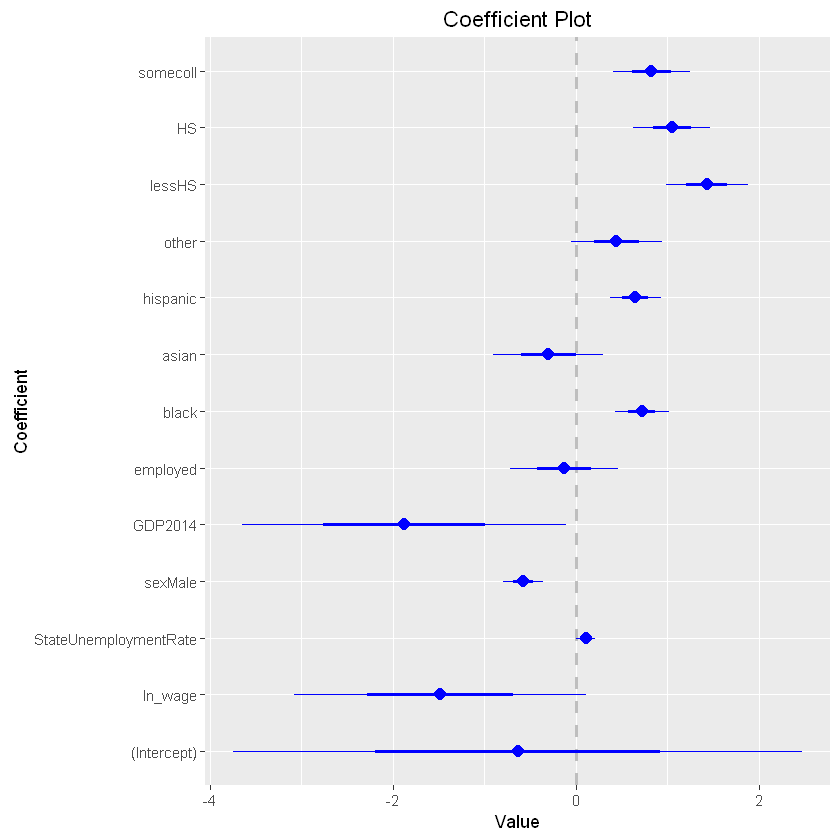

In [8]:
library(coefplot)
coefplot(lm.model, parm = -1)

In [9]:
library(car)

In [10]:
#avPlots(lm.model)

In [11]:
library(visreg)

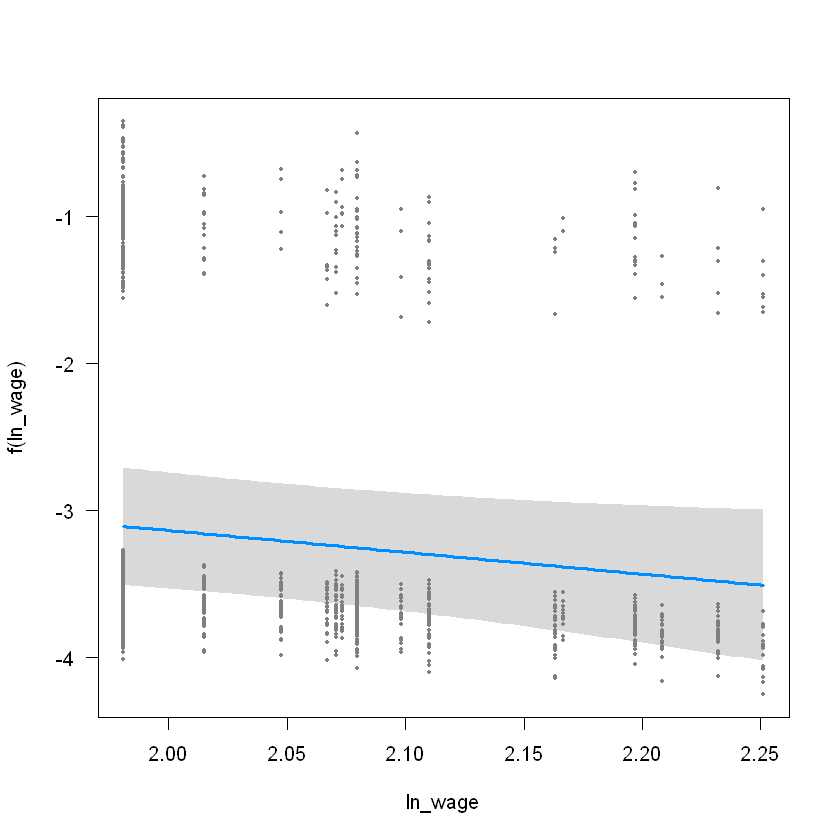

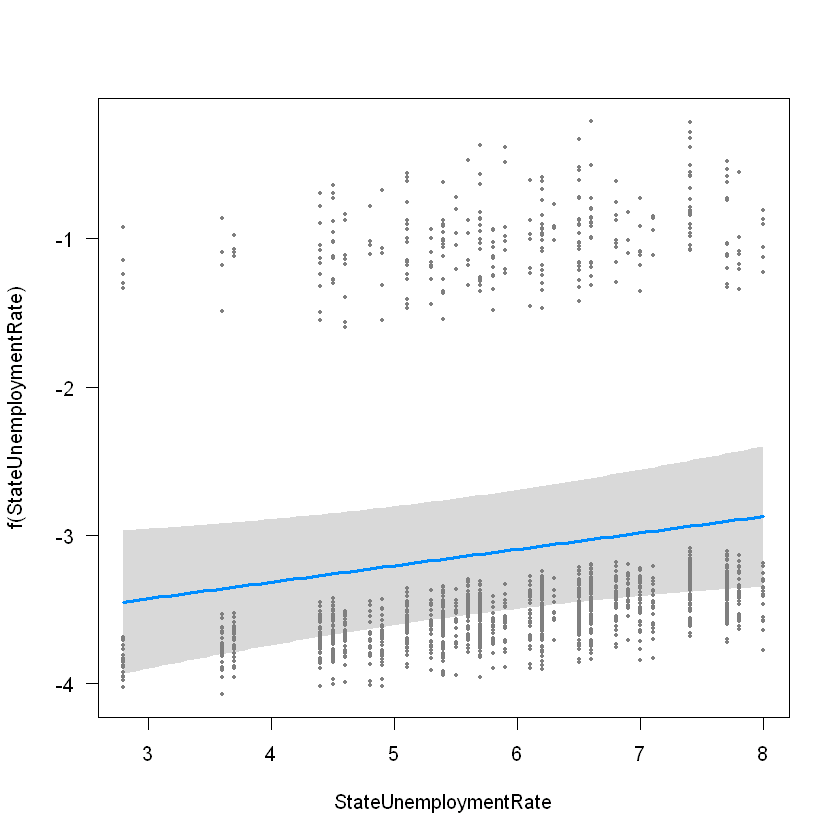

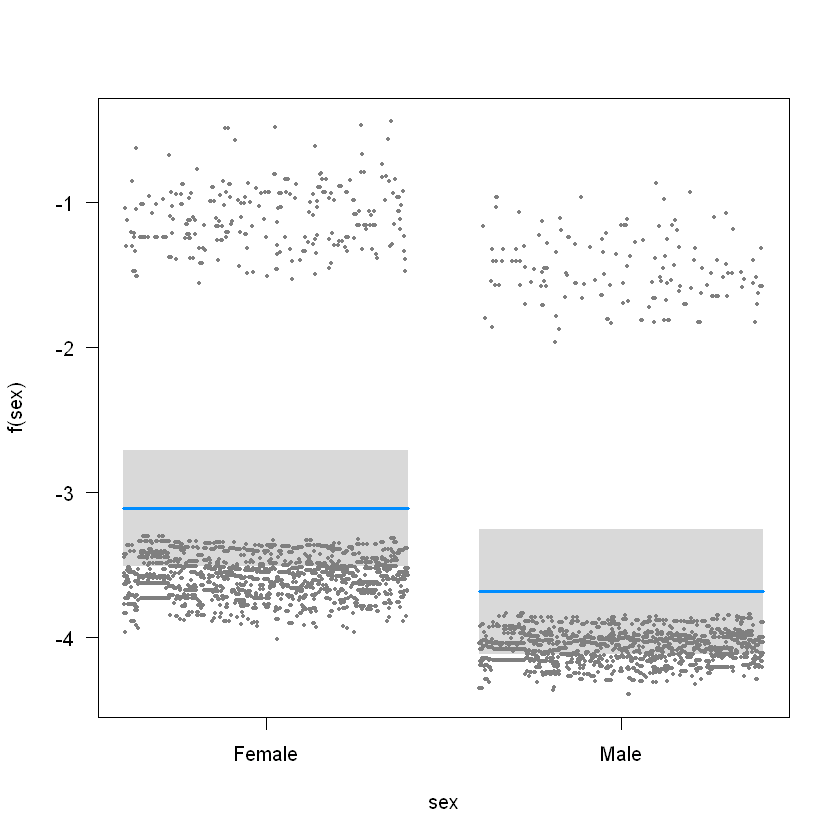

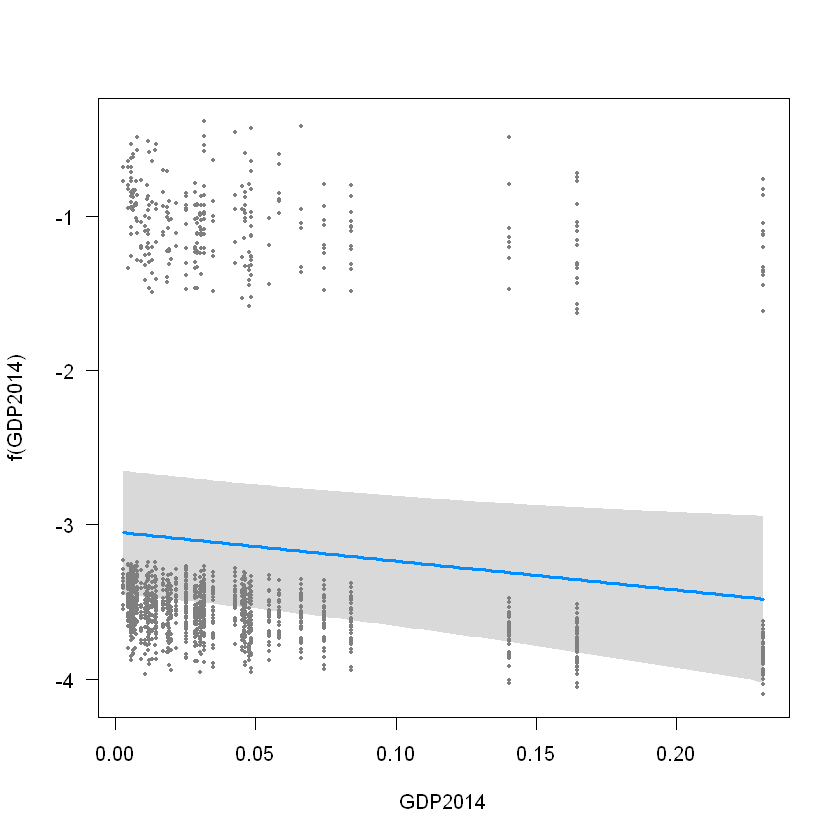

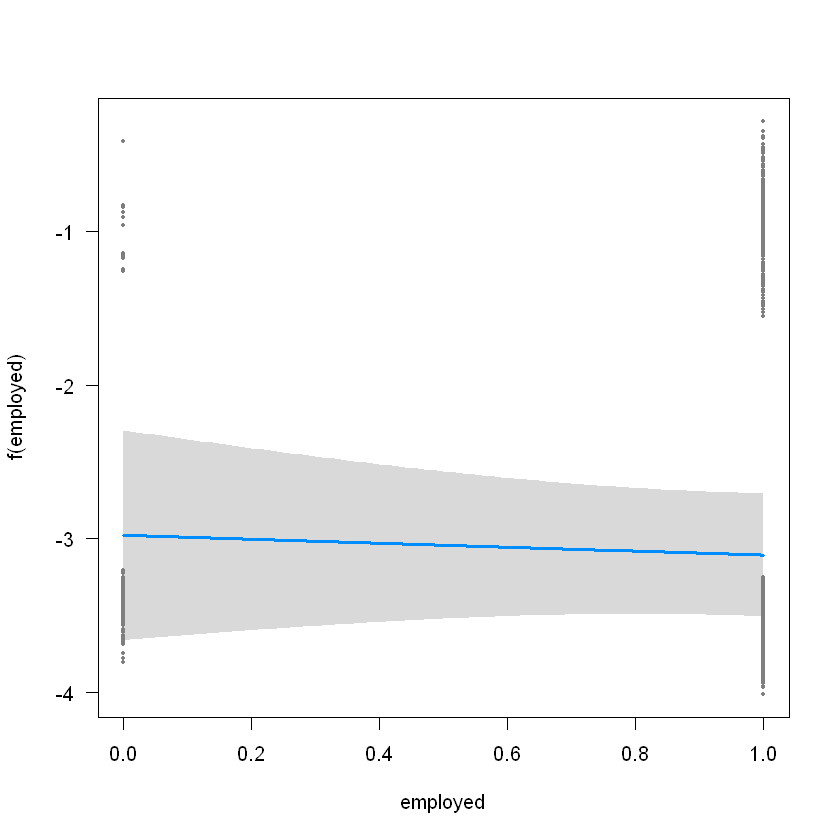

...

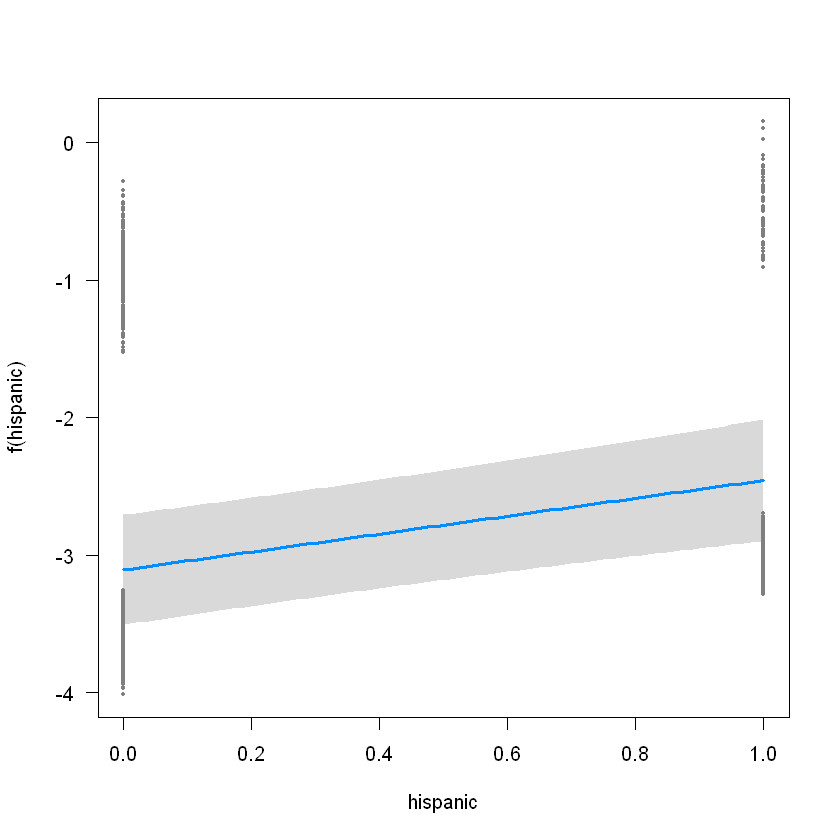

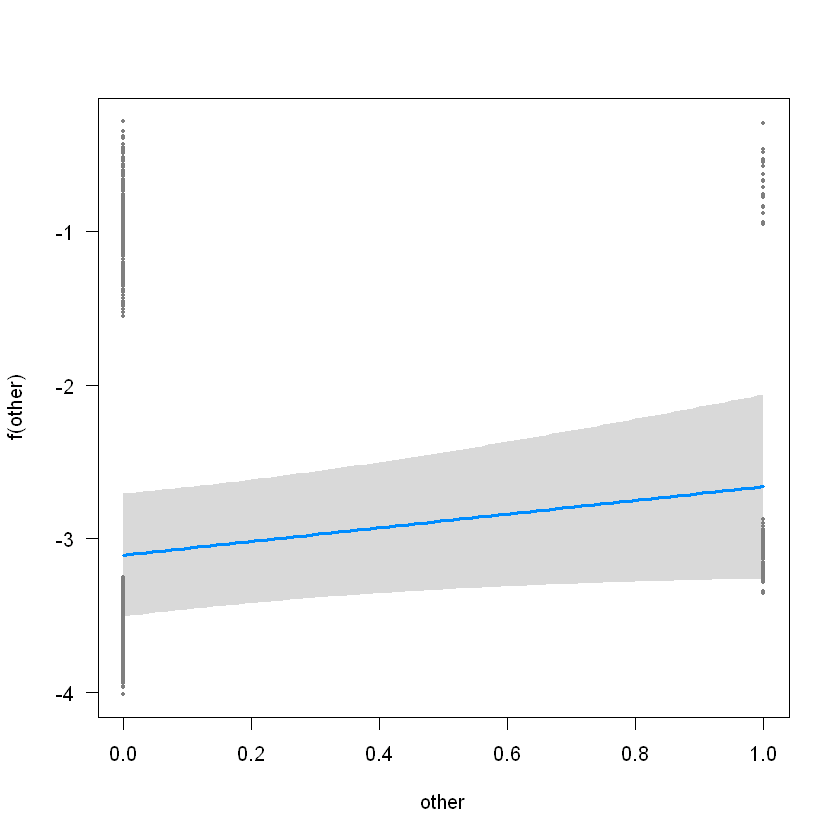

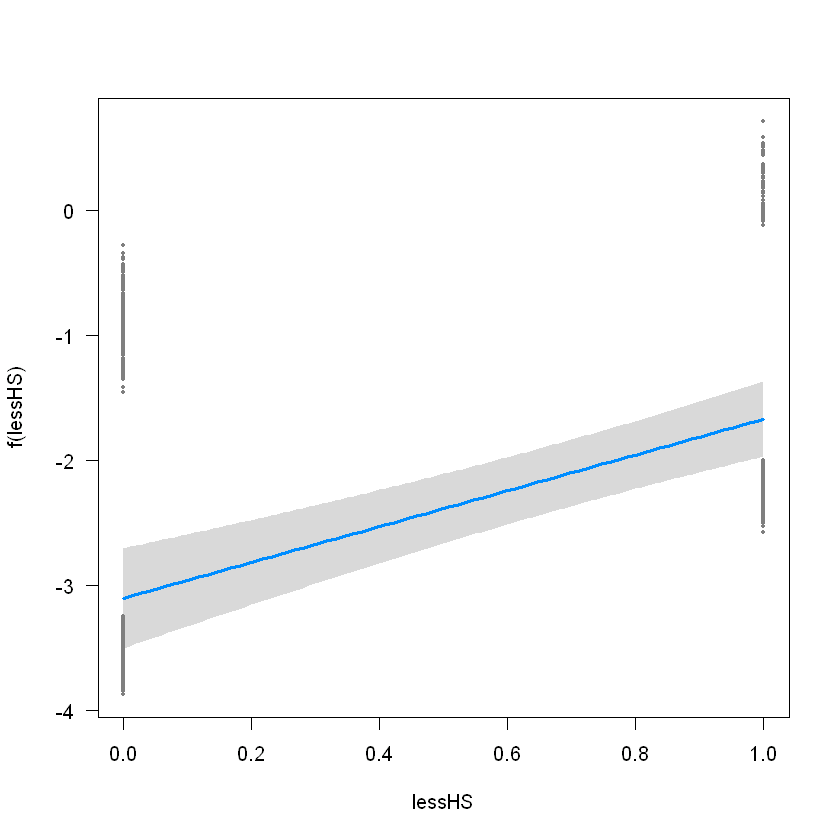

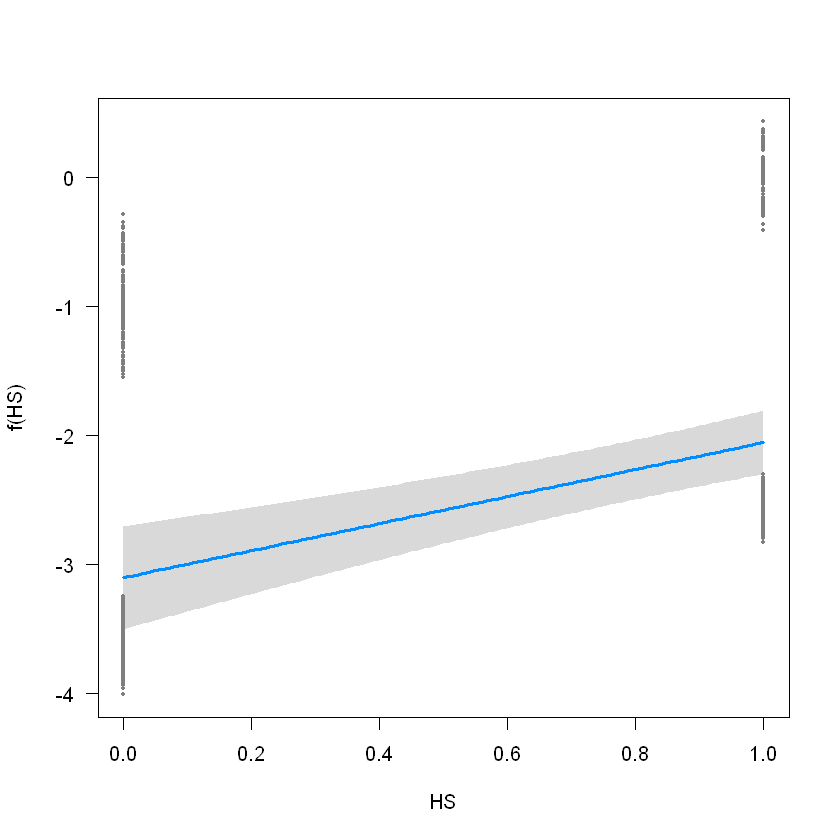

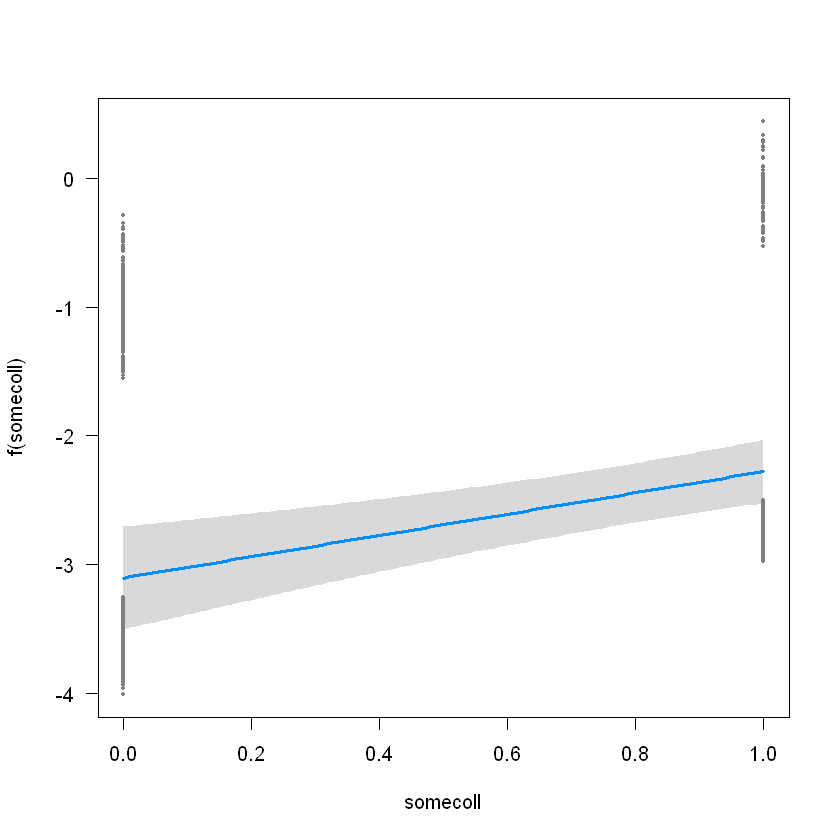

In [12]:
visreg(lm.model)

In [13]:
pframe = read.csv("prediction table.csv")

In [14]:
pframe[1,]

,ln_wage,StateUnemploymentRate,sex,GDP2014,employed,black,asian,hispanic,white,other,lessHS,HS,somecoll
1,1.98,5.929491,Female,0.06523563,1,1,0,0,0,0,1,0,0


In [15]:
library(ggplot2)

In [16]:
prediction=predict.glm(lm.model,newdata=pframe,type="response")

In [17]:
prediction=data.frame(prediction)
prediction$ln_wage=pframe$ln_wage

In [20]:
library(Rmisc)
predictionc = summarySE(prediction,measurevar = 'prediction',groupvars=c("ln_wage"))

In [21]:
predictionc

,ln_wage,N,prediction,sd,se,ci
1,1.98,9,0.1750936,0.05971087,0.01990362,0.04589784
2,2.25,9,0.1253608,0.04527523,0.01509174,0.03480162
3,2.31,9,0.1160731,0.04235896,0.01411965,0.03255998
4,2.48,9,0.09290462,0.03478052,0.01159351,0.02673467
5,2.71,9,0.06812028,0.02619176,0.008730588,0.02013277


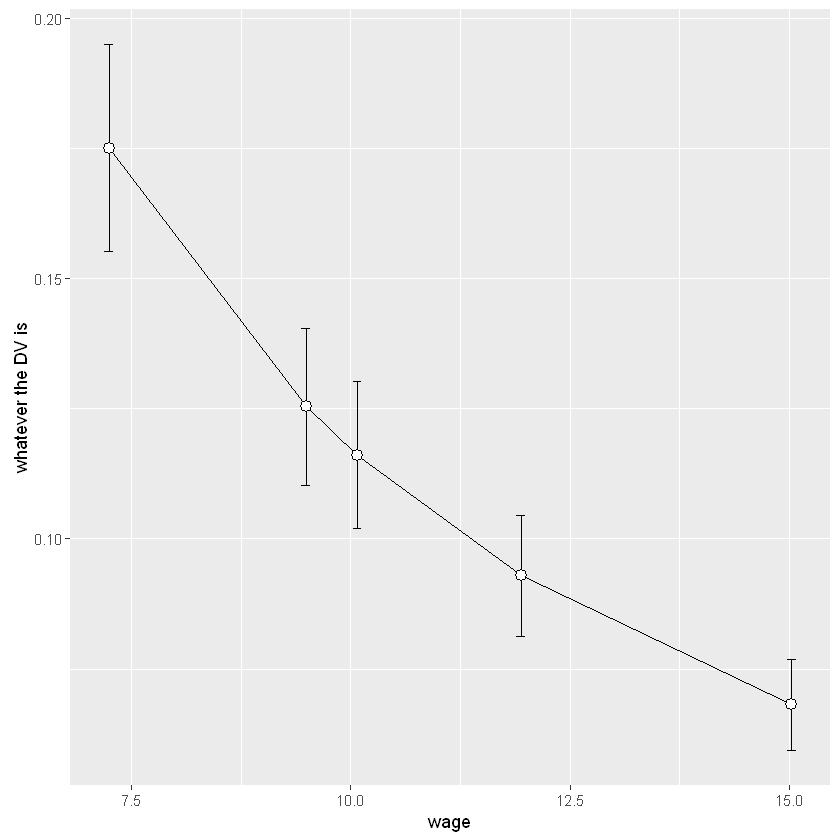

In [32]:
ggplot(predictionc,aes(x=exp(ln_wage),y=prediction)) +xlab('wage')+ylab('whatever the DV is')+geom_line()+
geom_errorbar(aes(ymin=prediction-se,ymax=prediction+se),colour='black',width=0.1)+geom_point(shape=21,size=3,fill='white')